# Compute and plot statistics on the performance of a Hit Tagging Model

A Hit Tagging model aims to predict the tag (0 for vertex activity, 1 for single particle, 2 for noise) of hits of an event in SFG. In this notebook we investigate the performances of such a model.

### Define parameters

In [1]:
# j=19 # id of the model (useful when testing many models)
j=""
recon_ver=True # do we use the reconstruced or the true vertex position
run_test=False # do we run the test this time or do we simply load the preexisting results
use_log_scale=False # do we use the log scale in the plos

### Define paths

In [8]:
model_path=f"../../models_weights/hittag_model_{j}.torch"
test_set_path="/scratch4/maubin/data/hittag_test"
scaler_file_path="../../sfgnets/datasets/scalers/scaler_hittag.p"
prediction_path=f"../../results/hit_tagging_model_{j}{'_true_verPos'  if not recon_ver else ''}_pred.pkl"

## Load the relevant objects

### Import libraries and load model

In [3]:
import os

# Manually specify the GPUs to use
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

import sys
import pickle as pk
import torch.nn as nn
import tqdm
import numpy as np
import torch
import importlib
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_fscore_support, classification_report, confusion_matrix, explained_variance_score, accuracy_score, ConfusionMatrixDisplay
import importlib



torch.multiprocessing.set_sharing_strategy('file_system')

    
from sfgnets import hit_tag_net
from sfgnets.hit_tag_net import plot as plot
from sfgnets.utils import minkunet
from sfgnets.datasets.constants import RANGES, CUBE_SIZE
importlib.reload(hit_tag_net)
importlib.reload(plot)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

num_classes = 3

# Define the model
model = minkunet.MinkUNet34B(in_channels=4, out_channels=num_classes, D=3).to(device)
# print(model)

Using cache found in /scratch/.maubin/cache/torch/hub/adeelh_pytorch-multi-class-focal-loss_master


In [4]:
# load model state dict
model.load_state_dict(torch.load(model_path))


<All keys matched successfully>

### Load dataset and predict, save and/or load results

In [5]:
# Create dataset object
dataset=hit_tag_net.SparseEvent(test_set_path,
                                scaler_file=scaler_file_path,
                                recon_ver=recon_ver,
                                aux=True,
                                # filtering_func=hit_tag_net.select_hits_near_vertex(cut=8.,dist_type="cube"),
                                # center_event=True,
                                # retagging_func=hit_tag_net.retag_cut(40.),
                                )

# Create dataloader object
full_loader=hit_tag_net.full_dataset(dataset,
                                     collate=hit_tag_net.collate_sparse_minkowski,)

In [6]:
## Test model on the entire dataset

if run_test:
    all_results = hit_tag_net.test_full(full_loader,
                            model,
                            progress_bar=True,
                            )

    with open(prediction_path, 'wb') as file:
        pk.dump(all_results,file)
        
    print('Done.')

In [9]:
## Load the results of the test
with open(prediction_path, 'rb') as file:
    all_results=pk.load(file)

### Get flattened array of true and predicted labels

In [10]:
## Create a datacontainer for the plots
data=plot.DataContainer(all_results=all_results,dataset=dataset)

In [11]:
## Example of finding events indexes that are ccqe, in the center of the detector and with at least 400 hits imax=1000
imax=1000
plot.intersect_list_indexes([plot.list_index_vertex_contained(data,imax=imax),
                             plot.list_index_number_hits(data,min_number_hits=400,imax=imax),
                             plot.list_index_interaction_type(data,interaction_type='ccqe',imax=imax)])

[843, 139, 966, 15]

In [12]:
## Event display
i=260 # choose one specific event
plot.plot_event_display(data,i);

Interaction type: ccppip
Particles involved with number of hits: pdg 0: 413   mu-: 94   pi+: 52   e-: 47   p: 27   n: 6


In [11]:
## Get a flat array of true and predicted labels
target_names = plot.target_names
val_true=data.val_true
y_pred=data.y_pred
val_pred=data.val_pred


In [12]:
## set the limits for the x axis of the plots
x_lim_dist=(0.5,2000) if use_log_scale else (0.5,200)
x_lim_charge=(0.5,2000) if use_log_scale else (0.5, 300)

## Overall performances of the model with classification report and confusion matrix

In [13]:
## Compute the confusion matrix and overall performances

plot.print_classification_report(data)
# conf_mat=confusion_matrix(val_true, val_pred)
# disp=ConfusionMatrixDisplay(confusion_matrix=conf_mat/np.sum(conf_mat)*100, display_labels=target_names).plot()
# disp.ax_.set_facecolor('white')
# disp.ax_.set_title(f'Confusion Matrix (in %) of the Hit-Tagging Model {j}')
# plt.show()

                 precision    recall  f1-score   support

Vertex activity      0.624     0.663     0.643    325712
       Single P      0.882     0.877     0.880   6807706
          Noise      0.932     0.934     0.933  12612133

       accuracy                          0.910  19745551
      macro avg      0.813     0.825     0.819  19745551
   weighted avg      0.910     0.910     0.910  19745551



## Distribution of predicted probabilities for each class

### Global predicted probabilities

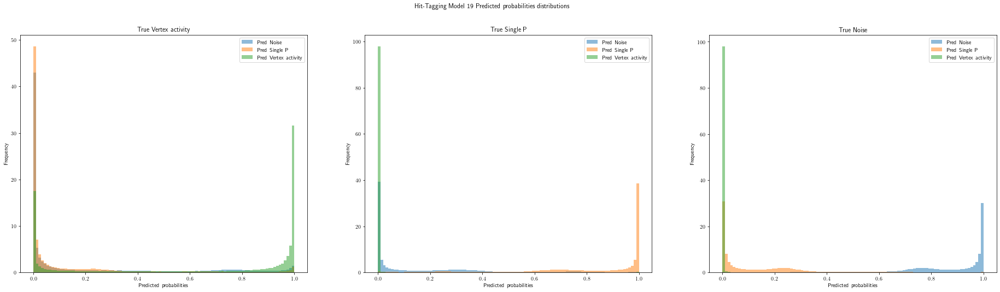

In [14]:
## Plot the distribution of predicted probabilities for each true label
## How to read the plot? For a given true label, the predicted label should be close to 1 while the other to 0

plot.plot_pred_proba(data,
                      model_name=str(j),
                      use_log_scale=use_log_scale);

### Predicted probabilities crossed with charge and vertex distance

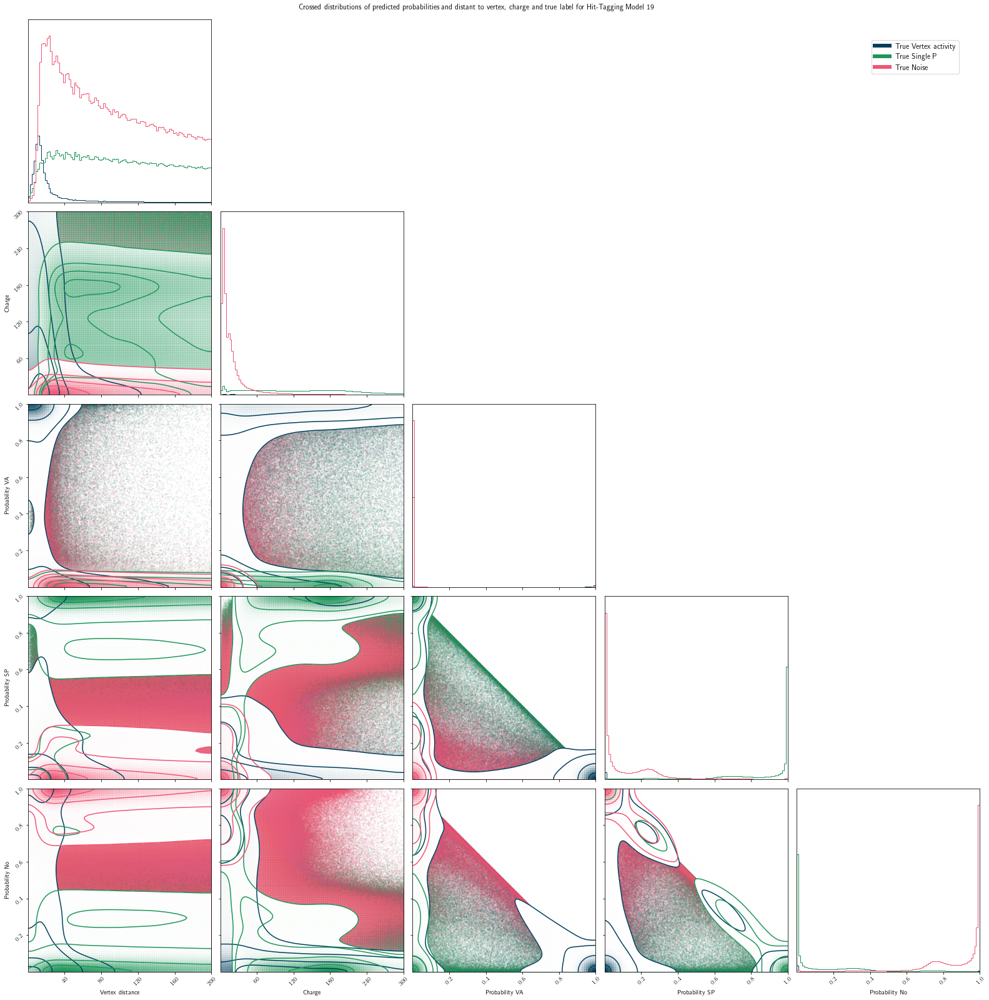

In [15]:
plot.plot_crossed_distribution(data,
                                model_name=str(j),
                                use_log_scale=use_log_scale);

In [16]:
## Fraction of VA hits further than 100 mm from the vertex
(data.distance_to_vertex[val_true==0]>100.).mean()

0.09371469273468586

## Performances filtered by specific features of the hits

### Overall performances

#### Overall performances depending on the hit distance to the vertex position

Computing performances over bins: 100%|██████████| 99/99 [00:06<00:00, 15.36it/s]


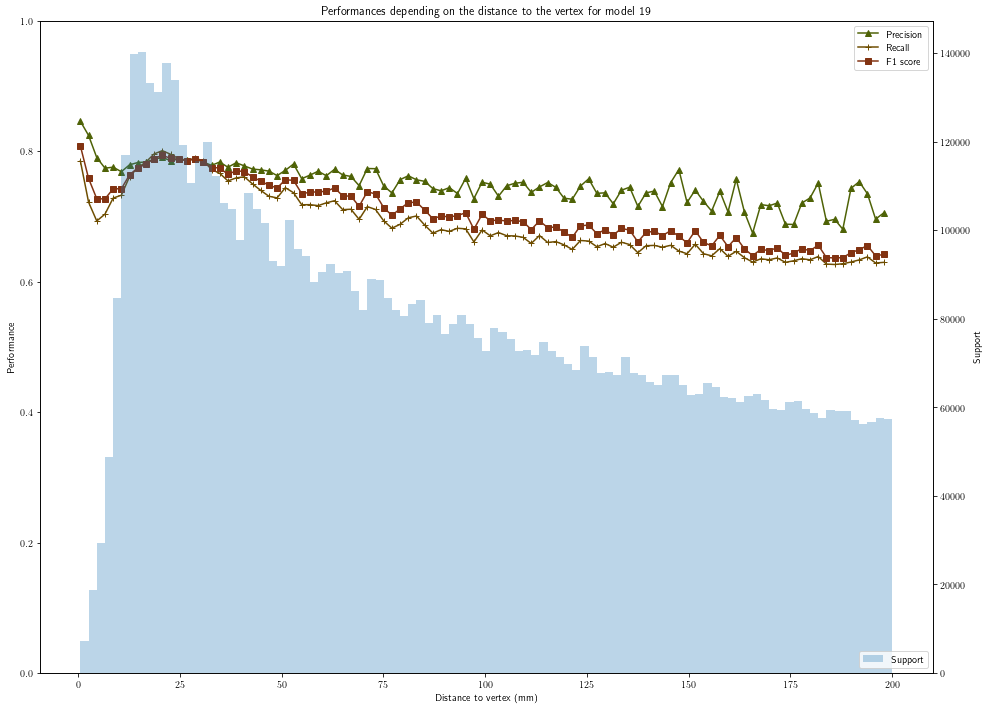

In [17]:
## Plot the performances depending on the distance to the vertex

plot.plot_perf_distance(data,model_name=str(j),use_log_scale=use_log_scale,x_lim_dist=x_lim_dist);

#### Overall performances depending on the hit charge

Computing performances over bins: 100%|██████████| 99/99 [00:14<00:00,  6.96it/s]


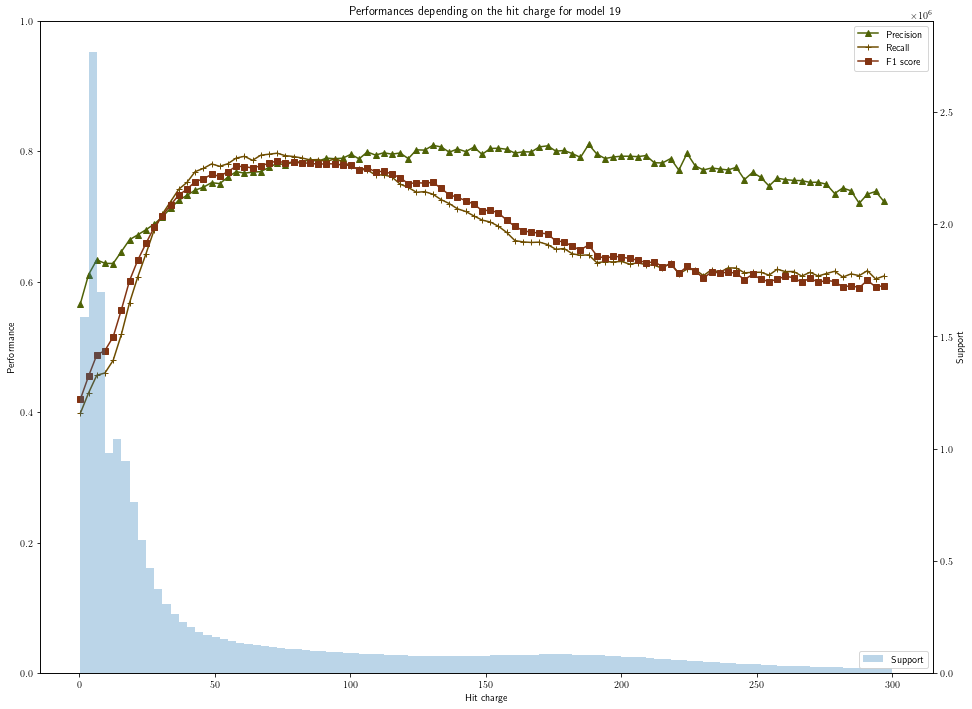

In [18]:
plot.plot_perf_charge(data,model_name=str(j),use_log_scale=use_log_scale,x_lim_charge=x_lim_charge);

#### Overall performances depending on the particle type

Computing performances over bars: 100%|██████████| 10/10 [00:06<00:00,  1.58it/s]


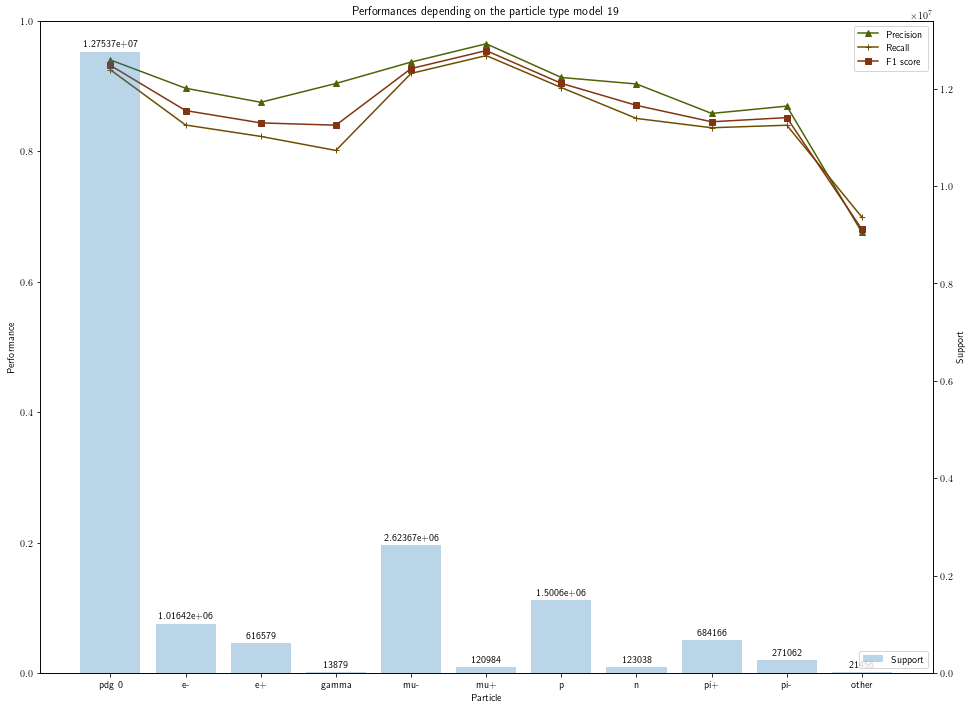

In [19]:
particles_to_consider_pdg=[11,-11,22, 13, -13, 2212, 2112, 211, -211]
plot.plot_perf_particle(data,model_name=str(j),particles_to_consider_pdg=particles_to_consider_pdg);

#### Overall performances depending on the interaction type

Computing performances over bars:  56%|█████▌    | 14/25 [00:05<00:02,  4.51it/s]/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

Computing performances over bars:  76%|███████▌  | 19/25 [00:05<00:00,  7.63it/s]/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: Undefin

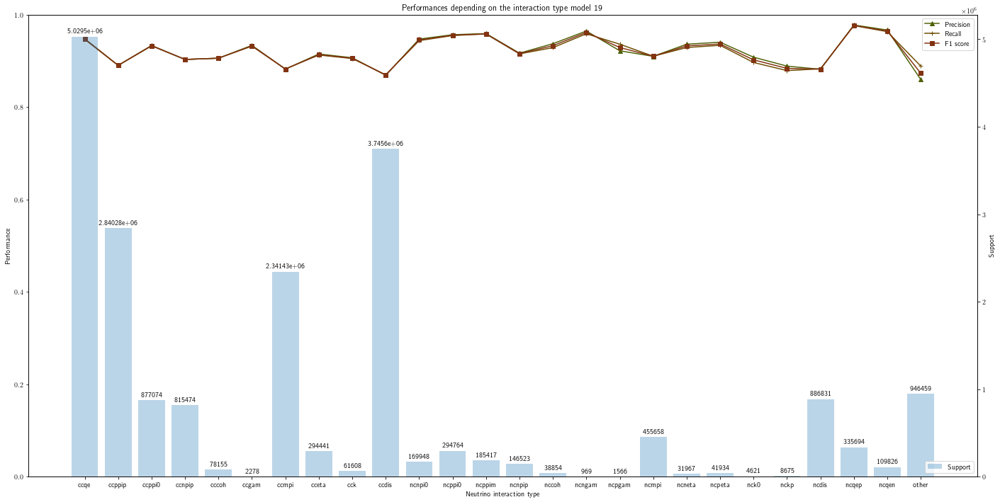

In [20]:
reaction_codes=[0, 1, 11, 12, 13, 16, 17, 21, 22, 23, 26, 31, 32, 33, 34, 36, 38, 39, 41, 42, 43, 44, 45, 46, 51, 52]
plot.plot_perf_interaction(data,model_name=str(j),reaction_codes=reaction_codes[1:]);

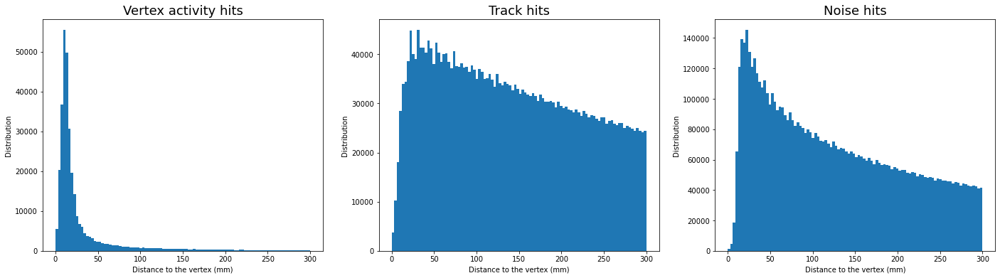

In [21]:

plt.rcParams['text.usetex'] = False
fig,axes=plt.subplots(nrows=1,ncols=3,figsize=(24,6), facecolor="white")
use_log_scale=False
y_log_scale=False
target_names=['Vertex activity','Track','Noise']
Nbins=100
ranges=(0,300)
for k,ax in enumerate(axes):
    # ax.set_xlabel("Hit charge (# of photoelectrons)")
    ax.set_xlabel("Distance to the vertex (mm)")
    ax.set_ylabel('Distribution')
    # ax.set_xscale('log' if use_log_scale else 'linear')

    # ax.hist(data.charge[(data.val_true==k)], bins=Nbins,  label="Support", range=ranges)
    ax.hist(data.distance_to_vertex[(data.val_true==k)], bins=Nbins,  label="Support", range=ranges)
    if y_log_scale:
        ax.set_yscale('log')        
    
    ax.set_title(f'{target_names[k]} hits', fontsize=18, pad=6)
        

            
# fig.suptitle(f"Distribution of the hit charges depending on the hit tag",fontsize=25,y=0.95)
fig.show();

### Performances depending on the true or predicted label

#### Performances depending on the true or predicted label and the hit distance to the vertex postion

Computing performances over bins by tag:   0%|          | 0/99 [00:00<?, ?it/s]/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no p

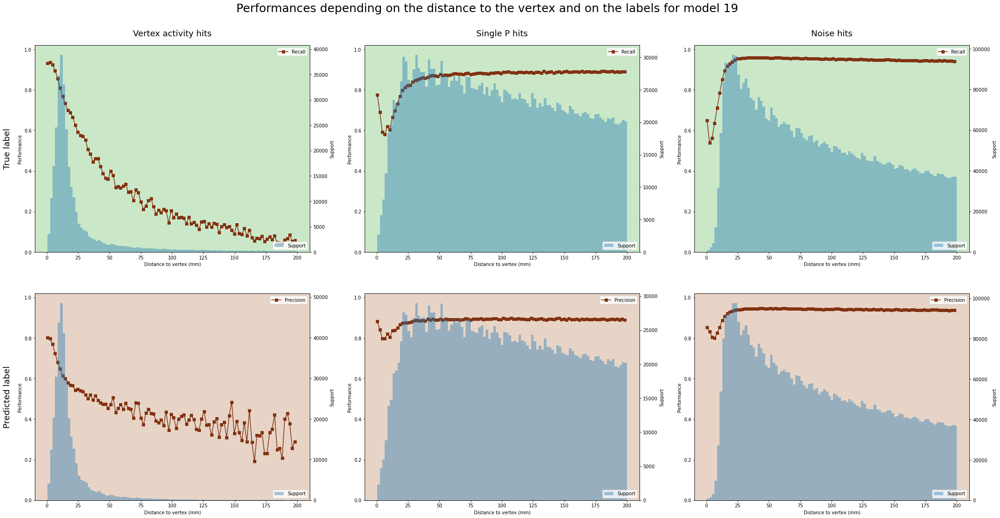

In [22]:
## Plot the efficiency depending on the true/pred label and the vertex position
plot.plot_perf_distance_by_tag(data,model_name=str(j),use_log_scale=use_log_scale,x_lim_dist=x_lim_dist);

#### Performances depending on the true or predicted label and the hit charge

Computing performances over bins by tag:   0%|          | 0/99 [00:00<?, ?it/s]/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no p

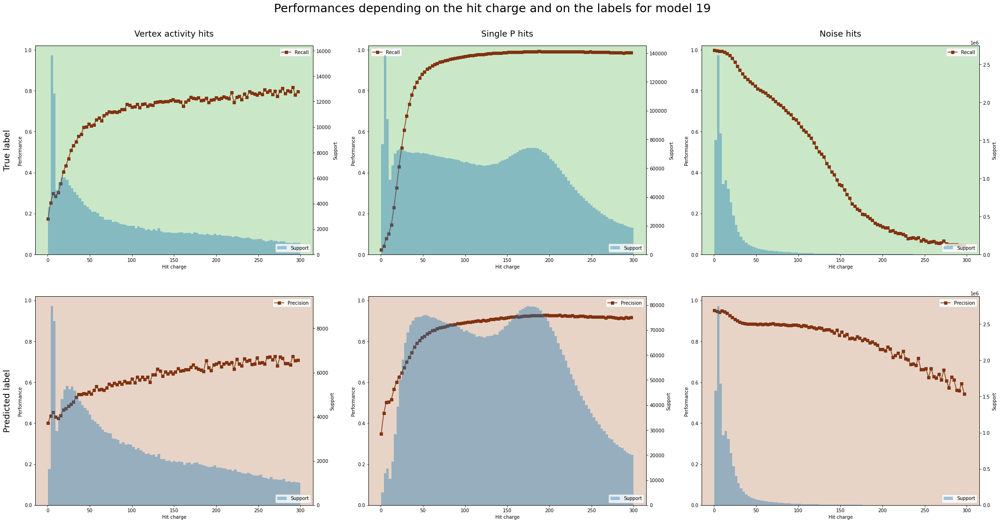

In [23]:
plot.plot_perf_charge_by_tag(data,model_name=str(j),use_log_scale=use_log_scale,x_lim_charge=x_lim_charge);

#### Performances depending on the true or predicted label and the particle type

Computing performances over bins bars:   0%|          | 0/10 [00:00<?, ?it/s]/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no pre

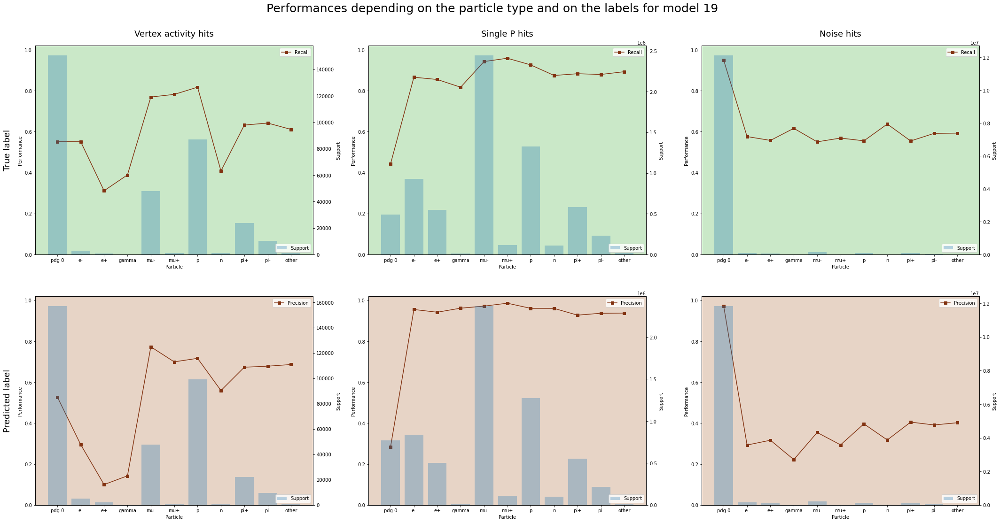

In [24]:
plot.plot_perf_particle_by_tag(data,model_name=str(j),particles_to_consider_pdg=particles_to_consider_pdg);

#### Performances depending on the true or predicted label and the interaction type

Computing performances over bins bars:   0%|          | 0/25 [00:00<?, ?it/s]

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/hom

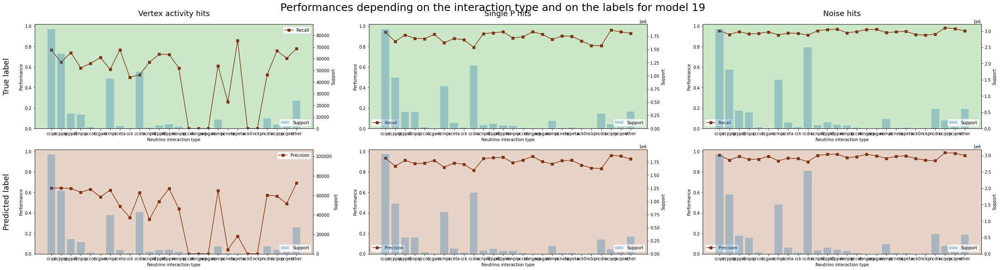

In [25]:
plot.plot_perf_interaction_by_tag(data,model_name=str(j),reaction_codes=reaction_codes[1:]);

## Event Displays

In [26]:
i=1
plot.plot_event_display(data,i);

Interaction type: ccqe
Particles involved with number of hits: pdg 0: 41   mu-: 12   e-: 4   p: 3


## Distribution of distances to the vertex

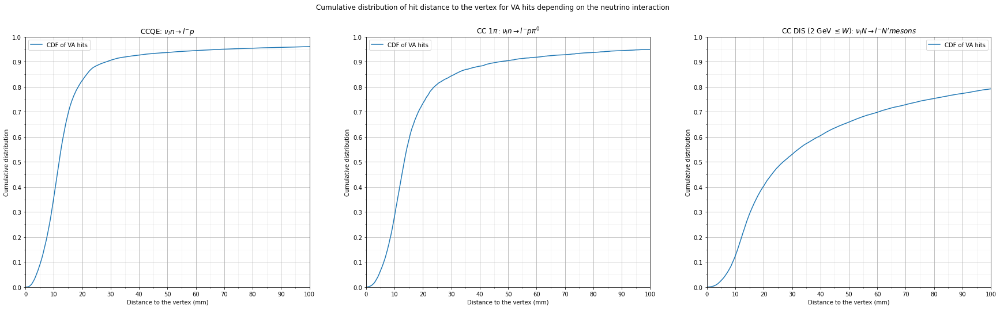

In [27]:
plot.plot_distance_by_interaction(data);

## Other stuff

Computing performances over bins by tag:   0%|          | 0/49 [00:00<?, ?it/s]/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/home/maubin/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no p

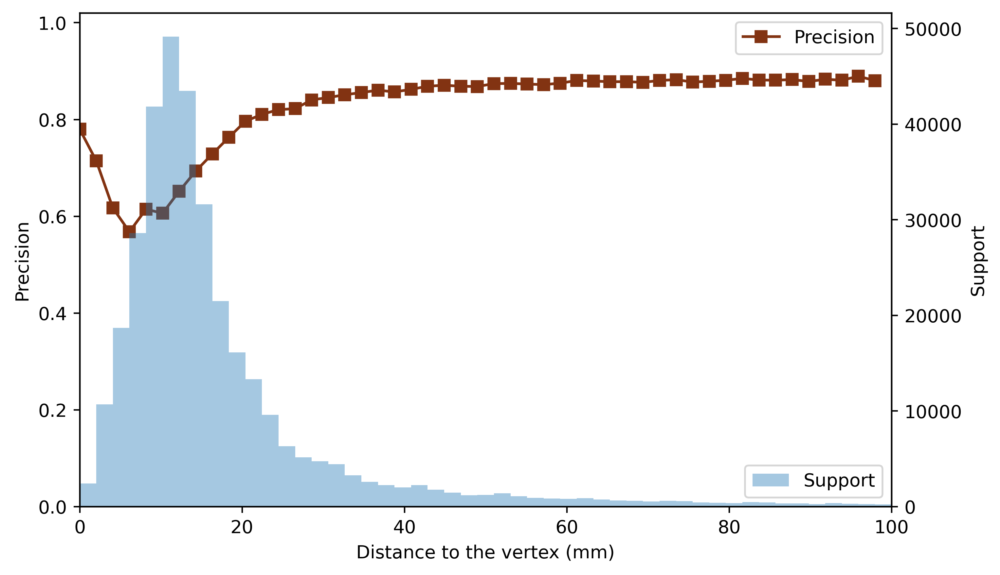

In [28]:
xlabel="Distance to the vertex (mm)"
Nbins=50
x_lim=(0,100)
plt.rcParams['text.usetex'] = False
eff,bins,vals=plot._get_perf_binning_by_tag(data,
                                             data.distance_to_vertex,
                                             lims=x_lim,
                                             Nbins=Nbins,
                                             use_log_scale=False,
                                             )

## Plot the efficiency depending on the true/pred label and a feature
fig,ax=plt.subplots(nrows=1,ncols=1,figsize=(8,5), facecolor="white",dpi=400)
ax2=[[0,0,0],[0,0,0]]
ax.plot(bins[:-1],eff[1][0],label="Precision",color=plot.color_list[5], marker="s")
ax.set_xlabel(xlabel)
ax.set_ylabel('Precision')
# ax.set_xscale('log' if use_log_scale else 'linear')
ax.set_xlim(x_lim)
ax.set_ylim(0.,1.02)
# ax.set_ylim(min(min(prec[k]),min(reca[k]),min(f1[k]))-0.05,max(max(prec[k]),max(reca[k]),max(f1[k]))+0.05)

ax2=ax.twinx()
ax2.hist(data.distance_to_vertex[(vals[1]==0)], bins=bins, alpha=0.4, label="Support")
ax2.set_ylabel('Support')
ax.legend()
ax2.legend(loc="lower right")


fig.show()

In [29]:
import pandas as pd

df=pd.DataFrame([[int(aux[0,1]),np.abs(int(aux[0,1])),(np.sign(int(aux[0,1]))+1)//2,plot.reaction_codes_short_labels_dict[int(np.abs(aux[0,1]))] if int(np.abs(aux[0,1])) in plot.reaction_codes_short_labels_dict.keys() else np.abs(int(aux[0,1])),plot.reaction_codes_long_labels_dict[int(np.abs(aux[0,1]))] if int(np.abs(aux[0,1])) in plot.reaction_codes_long_labels_dict.keys() else 'other', len(aux)] for aux in data.all_results['aux']],
             columns=['Reaction_code', 'Abs_reaction_code', 'Sign_reaction_code', 'Short_label','Long_label', 'len_event'])

df2=pd.DataFrame(np.concatenate([100*(data.val_true==0)[:,None], np.abs(data.aux[:,1].astype(int))[:,None]],axis=1),columns=['VA_tag','Abs_reaction_code']).groupby('Abs_reaction_code').mean()
df3=pd.DataFrame(np.concatenate([(data.val_true==0)[:,None], (data.val_pred==0)[:,None], ((data.val_true==0)*(data.val_pred==0))[:,None],np.abs(data.aux[:,1].astype(int))[:,None]],axis=1),columns=['VA_tag_true','VA_tag_pred','VA_tag_acc','Abs_reaction_code']).groupby('Abs_reaction_code').sum()

labels_map = pd.DataFrame([a for a in plot.reaction_codes_short_to_long_labels_dict.items()]+[(2,'not found'),(15,'not found'),(35,'not found')],columns=['Short_label','Long_label'])

In [30]:
df3['VA_precision']=df3['VA_tag_acc']/np.clip(df3['VA_tag_pred'],1,None)
df3['VA_recall']=df3['VA_tag_acc']/np.clip(df3['VA_tag_true'],1,None)
df3['VA_f1']=1/(1/np.clip(df3['VA_precision'],1e-9,None)+1/np.clip(df3['VA_recall'],1e-9,None))

In [31]:
df = df.groupby(by='Short_label').mean().reset_index().merge(df2,on='Abs_reaction_code').merge(df3,on='Abs_reaction_code').merge(df.groupby(by='Short_label')['len_event'].count().rename('count'),on='Short_label').merge(labels_map, on='Short_label').sort_values(by='count',ascending=False)

In [32]:
df['fraction']=df['count']/len(data.all_results['aux'])*100

In [36]:
df[['Short_label','Long_label','fraction','VA_precision','VA_recall','VA_f1']]

,Short_label,Long_label,fraction,VA_precision,VA_recall,VA_f1
12,ccqe,CCQE: $\nu_{l} n \rightarrow l^{-} p$,39.166,0.644663,0.769220,3.507276e-01
11,ccppip,CC 1$\pi: \nu_{l} p \rightarrow l^{-} p \pi^{+}$,13.862,0.642085,0.648571,3.226559e-01
8,ccmpi,CC (1.3 < W < 2 GeV): $\nu_{l} N \rightarrow l...,6.314,0.624149,0.578655,3.002709e-01
0,2,not found,6.188,0.691913,0.782456,3.672021e-01
4,ccdis,CC DIS (2 GeV $\leq W$): $\nu_{l} N \rightarro...,5.688,0.596781,0.523830,2.789656e-01
27,ncqep,NC elastic: $\nu_{l} n \rightarrow \nu_{l} n,5.536,0.564445,0.759777,3.238524e-01
9,ccnpip,CC 1$\pi: \nu_{l} n \rightarrow l^{-} n \pi^{+}$,4.358,0.600462,0.593260,2.984199e-01
10,ccppi0,CC 1$\pi: \nu_{l} n \rightarrow l^{-} p \pi^{0}$,4.092,0.640327,0.742124,3.437389e-01
24,ncppi0,NC 1$\pi: \nu_{l} p \rightarrow \nu_{l} p \pi^...,2.374,0.512108,0.726057,3.002990e-01
26,ncqen,NC elastic: $\nu_{l} p \rightarrow \nu_{l} p,2.182,0.491311,0.686741,2.864078e-01


In [34]:
import torchinfo

full_loader=hit_tag_net.full_dataset(dataset,
                                     collate=hit_tag_net.collate_sparse_minkowski,
                                     num_workers=1)

for dat in full_loader:
    print(torchinfo.summary(model,input_data=[hit_tag_net.arrange_sparse_minkowski(dat,device)],
                            col_names=["output_size", "num_params","params_percent", "input_size"],depth=1))
    break

Layer (type:depth-idx)                             Output Shape              Param #                   Param %                   Input Shape
MinkUNet34B                                        [178894, 4, 178894, 3]    --                             --                   --
├─MinkowskiConvolution: 1-1                        [178894, 4, 178894, 32]   16,000                      0.04%                   --
├─MinkowskiBatchNorm: 1-2                          [178894, 4, 178894, 32]   64                          0.00%                   --
├─MinkowskiReLU: 1-3                               [178894, 4, 178894, 32]   --                             --                   --
├─MinkowskiConvolution: 1-4                        [62207, 4, 62207, 32]     8,192                       0.02%                   --
├─MinkowskiBatchNorm: 1-5                          [62207, 4, 62207, 32]     64                          0.00%                   --
├─MinkowskiReLU: 1-6                               [62207, 4, 62207

In [35]:
model

MinkUNet34B(
  (conv0p1s1): MinkowskiConvolution(in=4, out=32, kernel_size=[5, 5, 5], stride=[1, 1, 1], dilation=[1, 1, 1])
  (bn0): MinkowskiBatchNorm(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv1p1s2): MinkowskiConvolution(in=32, out=32, kernel_size=[2, 2, 2], stride=[2, 2, 2], dilation=[1, 1, 1])
  (bn1): MinkowskiBatchNorm(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (block1): Sequential(
    (0): BasicBlock(
      (conv1): MinkowskiConvolution(in=32, out=32, kernel_size=[3, 3, 3], stride=[1, 1, 1], dilation=[1, 1, 1])
      (norm1): MinkowskiBatchNorm(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): MinkowskiConvolution(in=32, out=32, kernel_size=[3, 3, 3], stride=[1, 1, 1], dilation=[1, 1, 1])
      (norm2): MinkowskiBatchNorm(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): MinkowskiReLU()
    )
    (1): BasicBlock(
      (conv1): MinkowskiConvolution(in=32,